In [2]:
!pip install -Uq diffusers transformers fastcore

In [3]:
import logging 
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionPipeline
from fastcore.all import concat
from huggingface_hub import notebook_login
from PIL import Image

logging.disable(logging.WARNING)

torch.manual_seed(42)
if not (Path.home()/'.cache/huggingface'/'token').exists(): notebook_login()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [4]:
pipe= StableDiffusionPipeline.from_pretrained('CompVis/stable-diffusion-v1-4', varient= "fp16",torch_dtype= torch.float16).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [5]:
!ls ~/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4	models--stabilityai--sd-vae-ft-ema
models--openai--clip-vit-large-patch14	version.txt
models--pcuenq--jh_dreambooth_1000	version_diffusers_cache.txt


In [6]:
prompt= 'a robotic Elephant'

  0%|          | 0/50 [00:00<?, ?it/s]

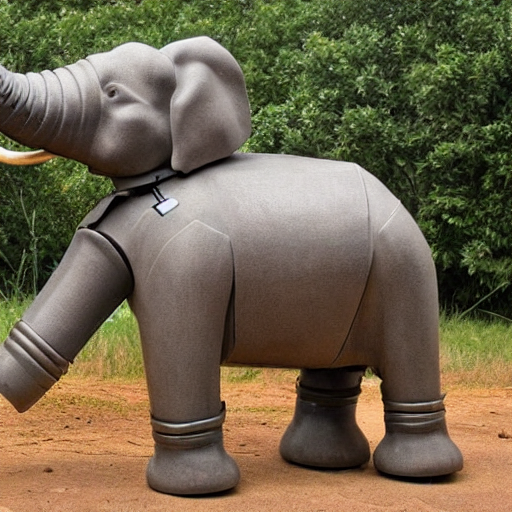

In [7]:
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

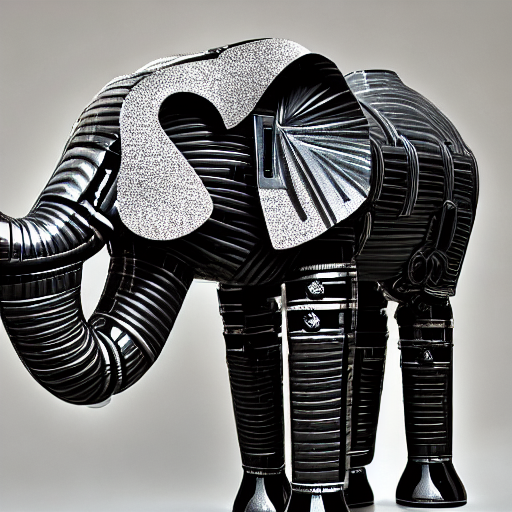

In [8]:
torch.manual_seed(1024)
pipe(prompt).images[0]

  0%|          | 0/3 [00:00<?, ?it/s]

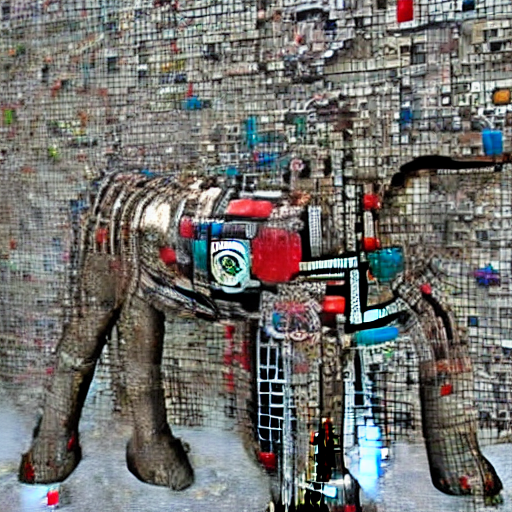

In [9]:
torch.manual_seed(1024)
pipe(prompt,num_inference_steps=3).images[0]

  0%|          | 0/16 [00:00<?, ?it/s]

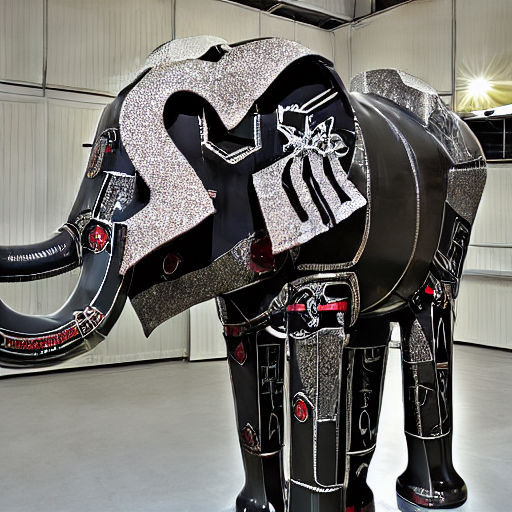

In [10]:
torch.manual_seed(1024)
pipe(prompt, num_inference_steps=16).images[0]

In [11]:
def image_grid(imgs,rows, cols):
    w,h= imgs[0].size
    grid= Image.new('RGB',size= (cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img,box=(i%cols*w,i//cols*h))
    return grid

In [12]:
num_rows, num_cols= 4,4
prompts= [prompt]*num_cols

In [13]:
images= concat(pipe(prompts, guidance_scale= g).images for g in [1.1, 3, 7, 14])

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

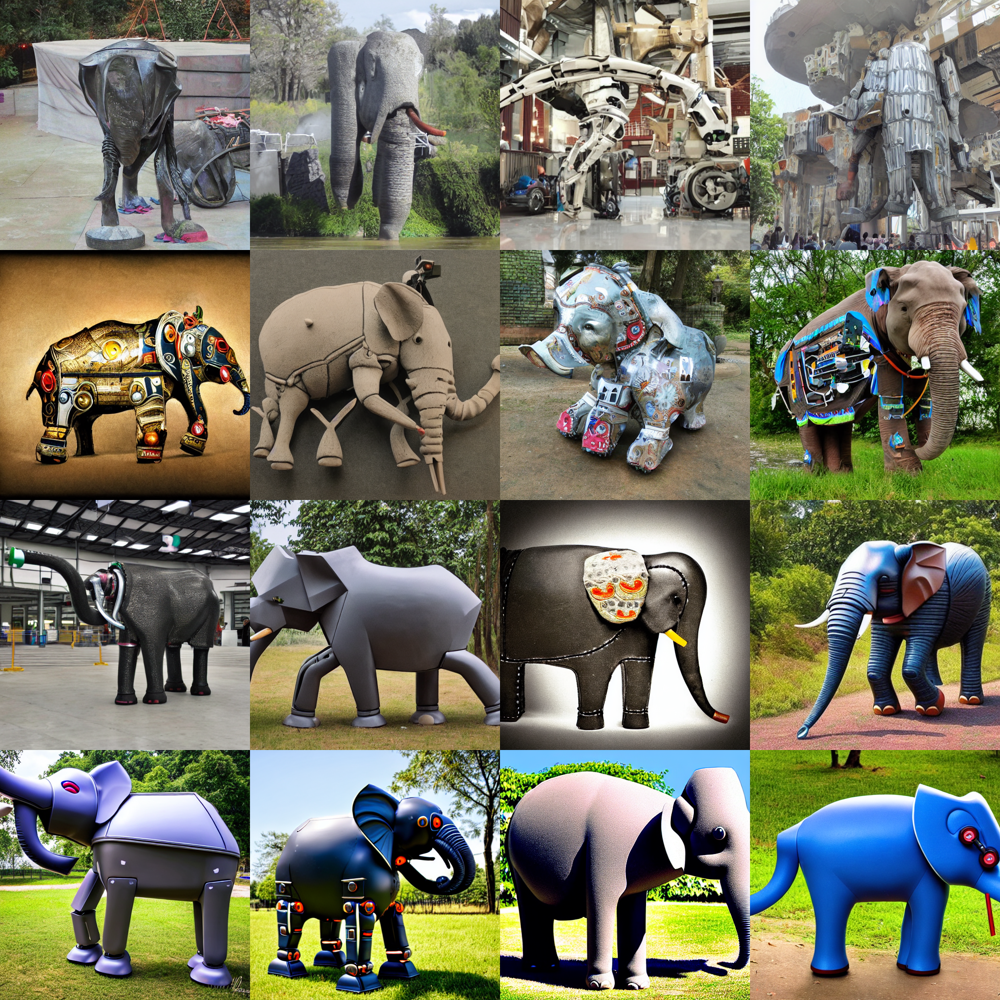

In [14]:
image_grid(images, rows= num_rows, cols= num_cols)

  0%|          | 0/50 [00:00<?, ?it/s]

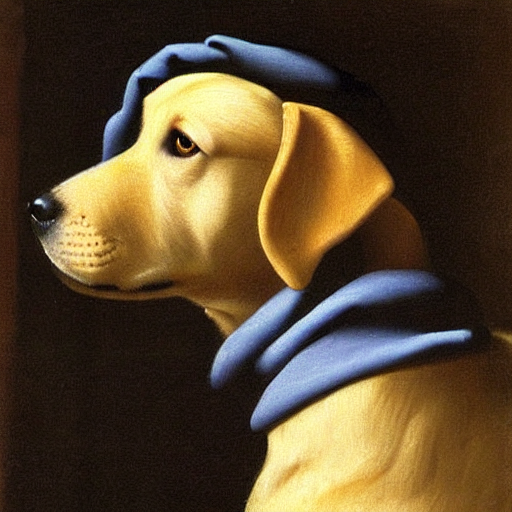

In [15]:
torch.manual_seed(1000)
prompt = "Labrador in the style of Vermeer"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

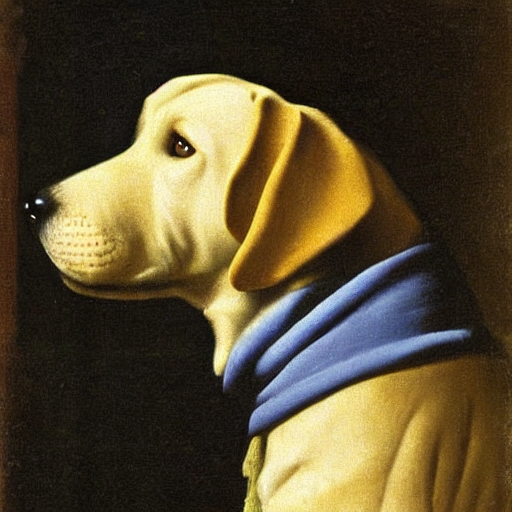

In [16]:
torch.manual_seed(1000)
pipe(prompt,negative_prompt='red').images[0]

In [17]:
from diffusers import StableDiffusionImg2ImgPipeline
from fastdownload import FastDownload

In [18]:
pipe= StableDiffusionImg2ImgPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    variant= "fp16",
    torch_dtype= torch.float16,
    

).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

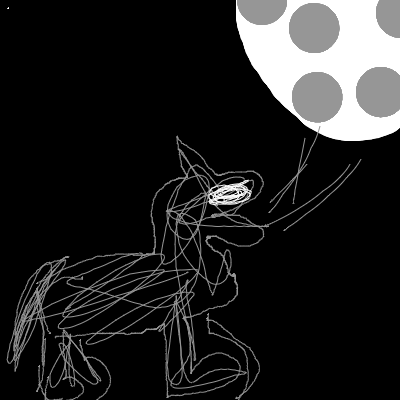

In [19]:
p= FastDownload().download('https://cdn-uploads.huggingface.co/production/uploads/1664665907257-noauth.png')
init_image=Image.open(p).convert('RGB')
init_image


/opt/conda/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img.py:663: FutureWarning: You have passed 3 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/40 [00:00<?, ?it/s]

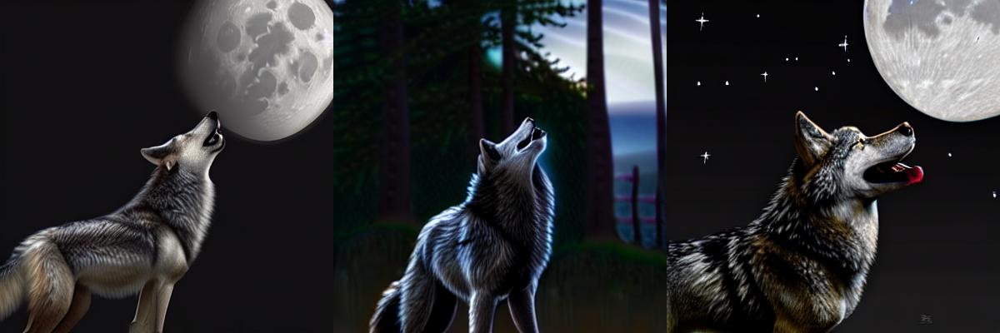

In [20]:
torch.manual_seed(1000)
prompt="Wolf howling at the moon, photorealistic 4K"
images= pipe(prompt= prompt, num_images_per_prompt=3,
            image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3)

In [21]:
init_image= images[0]


  0%|          | 0/40 [00:00<?, ?it/s]

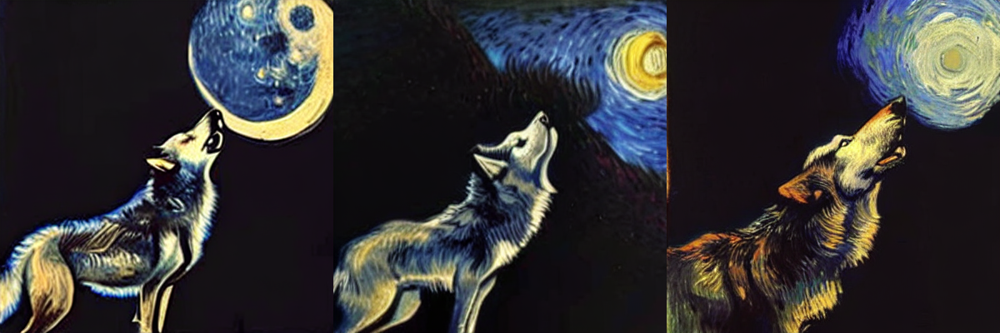

In [22]:
torch.manual_seed(1000)
prompt= "Oil painting of wolf howling at the moon by Van Gogh"
images= pipe(prompt= prompt, num_images_per_prompt=3, image=init_image,
            strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3)

In [23]:
pipe= StableDiffusionPipeline.from_pretrained('CompVis/stable-diffusion-v1-4', variant="fp16", torch_dtype=torch.float16) 
pipe= pipe.to('cuda')


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [24]:
embeds_url= "https://huggingface.co/sd-concepts-library/indian-watercolor-portraits/resolve/main/learned_embeds.bin"
embeds_path= FastDownload().download(embeds_url)
embeds_dict= torch.load(str(embeds_path), map_location='cpu')

In [25]:
tokenizer= pipe.tokenizer
text_encoder= pipe.text_encoder
new_token, embeds= next(iter(embeds_dict.items()))
embeds= embeds.to(text_encoder.dtype)
new_token

'<watercolor-portrait>'

In [26]:
assert tokenizer.add_tokens(new_token)==1, "Token already exists"

In [27]:
text_encoder.resize_token_embeddings(len(tokenizer))
new_token_id= tokenizer.convert_tokens_to_ids(new_token)
text_encoder.get_input_embeddings().weight.data[new_token_id]=embeds

  0%|          | 0/50 [00:00<?, ?it/s]

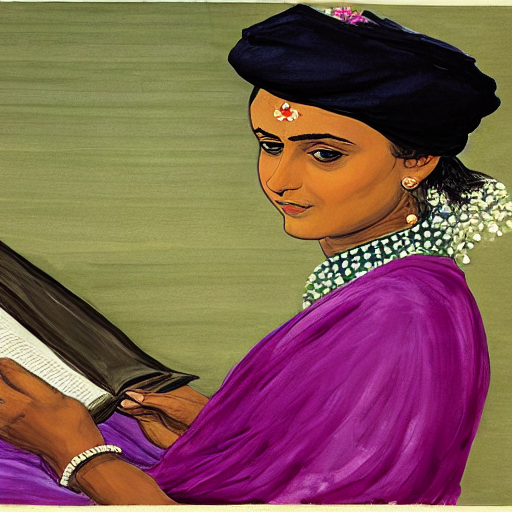

In [28]:
torch.manual_seed(1000)
image= pipe("women reading a book in the style of <watercolor-portrait>").images[0]
image

In [29]:
pipe= StableDiffusionPipeline.from_pretrained("pcuenq/jh_dreambooth_1000", torch_dtype=torch.float16)
pipe= pipe.to('cuda')

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

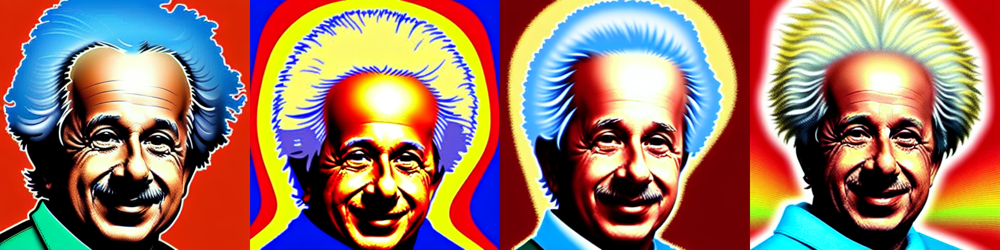

In [30]:
torch.manual_seed(1000)

prompt= "Painting of sks person as he is Einstein"
images= pipe(prompt, num_images_per_prompt=4).images
image_grid(images,1,4)

/opt/conda/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:806: FutureWarning: `callback` is deprecated and will be removed in version 1.0.0. Passing `callback` as an input argument to `__call__` is deprecated, consider using `callback_on_step_end`
  deprecate(
/opt/conda/lib/python3.10/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:812: FutureWarning: `callback_steps` is deprecated and will be removed in version 1.0.0. Passing `callback_steps` as an input argument to `__call__` is deprecated, consider using `callback_on_step_end`
  deprecate(


  0%|          | 0/50 [00:00<?, ?it/s]

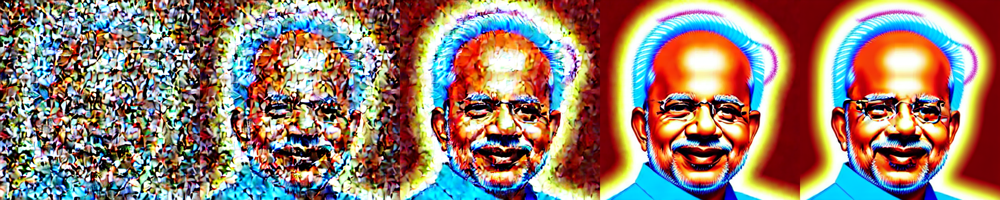

In [31]:
vae= pipe.vae
images=[]

def latents_callback(i,t,latents):
    latents= 1/0.18215 * latents
    image= vae.decode(latents).sample[0]
    image= (image/2 + 0.5).clamp(0,1)
    image= image.cpu().permute(1,2,0).numpy()
    images.extend(pipe.numpy_to_pil(image))

prompt= "Portrait painting of Narendra Modi looking sad."
torch.manual_seed(8000)
final_image= pipe(prompt, callback= latents_callback,callback_steps= 12).images[0]
images.append(final_image)
image_grid(images, rows=1, cols= len(images))

In [32]:
del pipe

In [33]:
from transformers import CLIPTextModel, CLIPTokenizer

In [34]:
tokenizer= CLIPTokenizer.from_pretrained('openai/clip-vit-large-patch14',torch_dtype=torch.float16)
text_encoder= CLIPTextModel.from_pretrained('openai/clip-vit-large-patch14', torch_dtype=torch.float16)

In [35]:
from diffusers import AutoencoderKL, UNet2DConditionModel

In [36]:
vae= AutoencoderKL.from_pretrained('stabilityai/sd-vae-ft-ema', torch_dtype=torch.float16).to("cuda")
unet= UNet2DConditionModel.from_pretrained('CompVis/stable-diffusion-v1-4', subfolder="unet", torch_dtype=torch.float16).to("cuda")


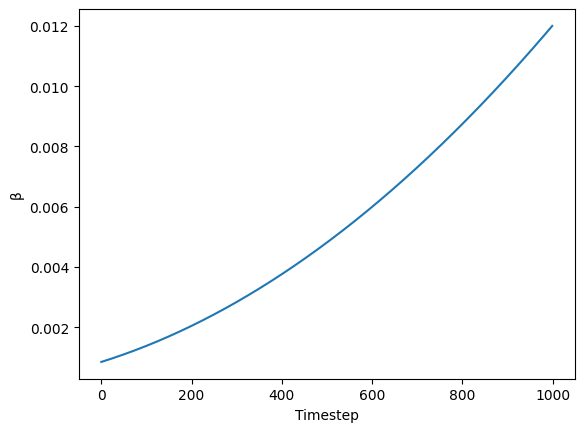

In [37]:
beta_start, beta_end = 0.00085, 0.012
plt.plot(torch.linspace(beta_start**0.5, beta_end**0.5, 1000)** 2)
plt.xlabel('Timestep')      #but this means noise reduction, wrongly used as it is nothing about time actually 
plt.ylabel('β');

In [38]:
from diffusers import LMSDiscreteScheduler

In [39]:
scheduler= LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end)

In [40]:
prompt= ['a photograph of an astronaut riding a horse']

height= 512
width= 512
num_inference_steps= 70
guidance_scale= 7.5
batch_size=1

In [41]:
text_input= tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_input['input_ids']

tensor([[49406,   320,  8853,   539,   550, 18376,  6765,   320,  4558, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
         49407, 49407, 49407, 49407, 49407, 49407, 49407]])

In [42]:
tokenizer.decode(8853)

'photograph'

In [43]:
text_input['attention_mask']

tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0]])

In [44]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

input_ids_on_device = text_input.input_ids.to(device)
text_encoder.to(device)

with torch.cuda.amp.autocast():
    text_embeddings = text_encoder(input_ids_on_device)[0].half()

text_embeddings_cpu = text_embeddings.cpu()
print(text_embeddings_cpu.shape)


torch.Size([1, 77, 768])


In [45]:
max_length= text_input.input_ids.shape[-1]
uncond_input=tokenizer(
    [""]*batch_size, padding='max_length', max_length=max_length, return_tensors="pt"
)
uncond_embeddings= text_encoder(uncond_input.input_ids.to('cuda'))[0].half()
uncond_embeddings.shape
                                

torch.Size([1, 77, 768])

In [46]:
text_embeddings= torch.cat([uncond_embeddings, text_embeddings])

In [47]:
torch.manual_seed(100)
latents= torch.randn((batch_size, unet.in_channels, height//8, width // 8))
latents=latents.to('cuda').half()
latents.shape

/tmp/ipykernel_117/1454140800.py:2: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents= torch.randn((batch_size, unet.in_channels, height//8, width // 8))


torch.Size([1, 4, 64, 64])

In [48]:
scheduler.set_timesteps(num_inference_steps)

In [49]:
latents= latents*scheduler.init_noise_sigma

In [50]:
scheduler.timesteps

tensor([999.0000, 984.5217, 970.0435, 955.5652, 941.0870, 926.6087, 912.1304,
        897.6522, 883.1739, 868.6957, 854.2174, 839.7391, 825.2609, 810.7826,
        796.3043, 781.8261, 767.3478, 752.8696, 738.3913, 723.9130, 709.4348,
        694.9565, 680.4783, 666.0000, 651.5217, 637.0435, 622.5652, 608.0870,
        593.6087, 579.1304, 564.6522, 550.1739, 535.6957, 521.2174, 506.7391,
        492.2609, 477.7826, 463.3044, 448.8261, 434.3478, 419.8696, 405.3913,
        390.9131, 376.4348, 361.9565, 347.4783, 333.0000, 318.5217, 304.0435,
        289.5652, 275.0869, 260.6087, 246.1304, 231.6522, 217.1739, 202.6956,
        188.2174, 173.7391, 159.2609, 144.7826, 130.3044, 115.8261, 101.3478,
         86.8696,  72.3913,  57.9130,  43.4348,  28.9565,  14.4783,   0.0000])

In [51]:
scheduler.sigmas

tensor([25.1461, 23.0511, 21.1550, 19.4373, 17.8796, 16.4656, 15.1806, 14.0118,
        12.9476, 11.9775, 11.0924, 10.2840,  9.5448,  8.8684,  8.2486,  7.6802,
         7.1584,  6.6788,  6.2375,  5.8311,  5.4565,  5.1107,  4.7912,  4.4956,
         4.2219,  3.9682,  3.7327,  3.5139,  3.3104,  3.1208,  2.9440,  2.7789,
         2.6246,  2.4802,  2.3448,  2.2178,  2.0985,  1.9862,  1.8804,  1.7806,
         1.6863,  1.5971,  1.5125,  1.4323,  1.3560,  1.2835,  1.2143,  1.1482,
         1.0850,  1.0244,  0.9663,  0.9104,  0.8565,  0.8045,  0.7543,  0.7056,
         0.6582,  0.6122,  0.5672,  0.5232,  0.4799,  0.4373,  0.3950,  0.3529,
         0.3106,  0.2676,  0.2231,  0.1755,  0.1205,  0.0292,  0.0000])

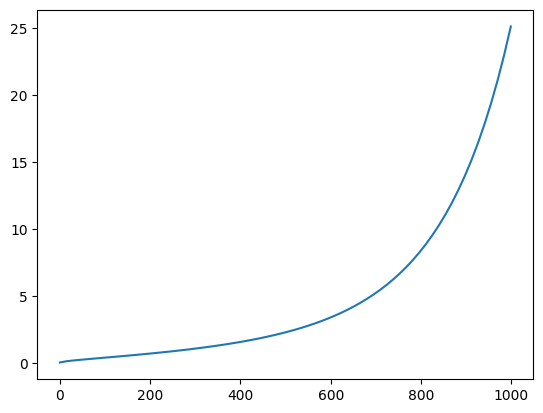

In [52]:
plt.plot(scheduler.timesteps, scheduler.sigmas[:-1]);

In [53]:
from tqdm.auto import tqdm

In [54]:
for i, t in enumerate(tqdm(scheduler.timesteps)):
    input= torch.cat([latents]*2)
    input= scheduler.scale_model_input(input,t)
    
    with torch.no_grad(): pred= unet(input, t , encoder_hidden_states=text_embeddings).sample
    pred_uncond, pred_text= pred.chunk(2)
    pred= pred_uncond+ guidance_scale*(pred_text - pred_uncond)
    latents= scheduler.step(pred,t, latents).prev_sample

  0%|          | 0/70 [00:00<?, ?it/s]

In [55]:
with torch.no_grad(): image= vae.decode(1/0.18215* latents).sample


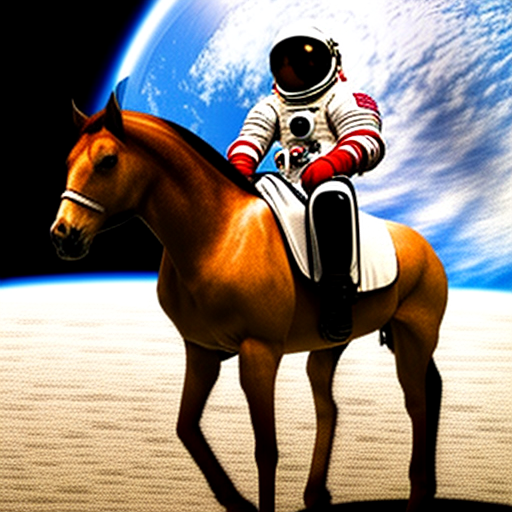

In [56]:
image= (image/2+0.5).clamp(0,1)
image= image[0].detach().cpu().permute(1,2,0).numpy()
image=(image*255).round().astype('uint8')
Image.fromarray(image)

In [57]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of grant wood'
]

In [58]:
text_input= tokenizer(prompts, padding= 'max_length', max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_embeddings= text_encoder(text_input.input_ids.to('cuda'))[0].half()


In [59]:
max_length= text_input.input_ids.shape[-1]
uncond_input= tokenizer([""]*len(prompts),padding= "max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings= text_encoder(uncond_input.input_ids.to("cuda"))[0].half()
emb= torch.cat([uncond_embeddings,text_embeddings])

In [60]:
torch.manual_seed(100)
g= guidance_scale

In [61]:
latents = torch.randn((len(prompts),unet.config.in_channels, height//8, width//8))
scheduler.set_timesteps(num_inference_steps)
latents= latents.to('cuda').half()*scheduler.init_noise_sigma


In [62]:
with torch.no_grad(): image= vae.decode(1/0.18215 * latents).sample
res= (image/ 2+ 0.5).clamp(0,1)

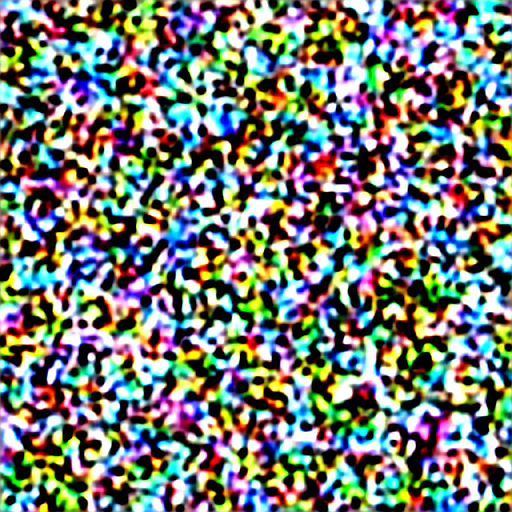

In [63]:

image = res[0].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)

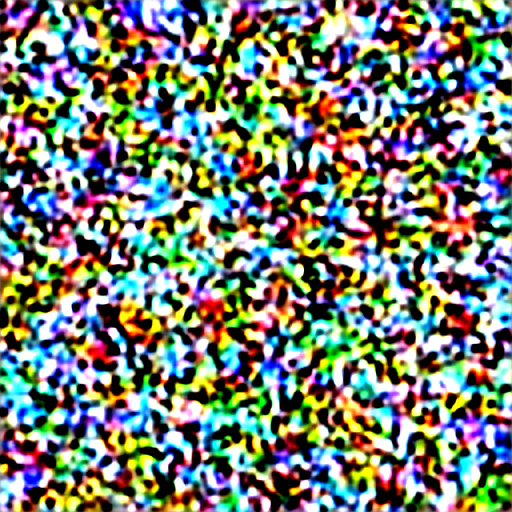

In [64]:
image = res[1].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)
